In [7]:
import pandas as pd
df = pd.read_csv('C:/Users/thale/Downloads/cat_acidentes.csv', sep=';')

In [8]:
df

,data_extracao,predial1,queda_arr,data,feridos,feridos_gr,mortes,morte_post,fatais,auto,...,longitude,latitude,log1,log2,tipo_acid,dia_sem,hora,noite_dia,regiao,consorcio
0,2023-11-01 01:33:25,0.0,0.0,2020-10-17 00:00:00,1,0,0,0,0,3,...,0.000000,0.000000,R MARCOS MOREIRA,R GASTON ENGLERT,ABALROAMENTO,SÁBADO,19:00:00.0000000,NOITE,NORTE,NaN
1,2023-11-01 01:33:25,170.0,0.0,2018-01-01 00:00:00,1,0,0,0,0,1,...,-51.214455,-30.122420,R CASEMIRO DE SOUZA,NaN,ATROPELAMENTO,SEGUNDA-FEIRA,00:30:00.0000000,NOITE,SUL,NaN
2,2023-11-01 01:33:25,2617.0,0.0,2018-01-01 00:00:00,0,0,0,0,0,1,...,-51.203106,-30.073318,AV PROF OSCAR PEREIRA,NaN,COLISÃO,SEGUNDA-FEIRA,07:55:00.0000000,DIA,SUL,NaN
3,2023-11-01 01:33:25,1590.0,0.0,2018-01-01 00:00:00,1,0,0,0,0,1,...,-51.134118,-30.229493,AV BOA VISTA,NaN,CHOQUE,SEGUNDA-FEIRA,20:18:00.0000000,NOITE,SUL,NaN
4,2023-11-01 01:33:25,0.0,0.0,2018-01-01 00:00:00,1,0,0,0,0,1,...,NaN,NaN,AV BOA VISTA,NaN,CHOQUE,SEGUNDA-FEIRA,11:00:00.0000000,DIA,SUL,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
73555,2023-11-01 01:33:25,1669.0,0.0,2023-10-26 00:00:00,0,0,0,0,0,2,...,-51.197089,-30.033105,R QUINTINO BOCAIUVA,NaN,ABALROAMENTO,QUINTA-FEIRA,13:45:00.0000000,DIA,LESTE,NaN
73556,2023-11-01 01:33:25,3.0,0.0,2023-10-26 00:00:00,0,0,0,0,0,2,...,-51.204285,-30.037780,R SILVA SO,NaN,ABALROAMENTO,QUINTA-FEIRA,14:00:00.0000000,DIA,LESTE,NaN
73557,2023-11-01 01:33:25,128.0,0.0,2023-10-26 00:00:00,0,0,0,0,0,2,...,-51.176752,-30.047680,R ENG ANTONIO CARLOS TIBIRICA,R CEL AURELIO DO AMARAL,ABALROAMENTO,QUINTA-FEIRA,17:25:00.0000000,DIA,LESTE,NaN
73558,2023-11-01 01:33:25,726.0,0.0,2023-10-26 00:00:00,0,0,0,0,0,2,...,-51.188450,-30.026754,R ANITA GARIBALDI,R ARTUR ROCHA,ABALROAMENTO,QUINTA-FEIRA,09:40:00.0000000,DIA,LESTE,NaN


In [15]:
!pip install folium geopy

In [18]:
import folium
from geopy.geocoders import Nominatim
cidade = "Restinga, São Paulo"
geolocator = Nominatim(user_agent="my_geocoder")
location = geolocator.geocode(cidade)
if location is not None:
    latitude = location.latitude
    longitude = location.longitude

    # Crie o mapa usando folium com as coordenadas obtidas
    mapa = folium.Map(location=[latitude, longitude], zoom_start=11)

    # Adicione um marcador para a localização
    folium.Marker([latitude, longitude], popup=cidade).add_to(mapa)

    # Exiba o mapa
    mapa.save("mapa_restinga_sao_paulo.html")
    print("Mapa salvo com sucesso!")
else:
    print("Localização não encontrada para a cidade de", cidade)
mapa

Mapa salvo com sucesso!


In [9]:
!pip install folium

     -------------------------------------- 100.3/100.3 kB 5.6 MB/s eta 0:00:00


In [19]:
#Utilizando biblioteca folium e um plug in para mapas de calor heatMap
#Função map para criar um mapa da localização que desejamos.
import folium
from folium.plugins import HeatMap

mapa = folium.Map(location=[-30.1, -51.15], zoom_start=11)

#Construindo o mapa de calor (HeatMap) em cima do nosso mapa
coordenadas = list(zip(df.latitude, df.longitude))
mapa_calor = HeatMap(coordenadas)
mapa.add_child(mapa_calor)

mapa

#Problema há valores nulos ValueError: Location values cannot contain NaNs.

ValueError: Location values cannot contain NaNs.

In [21]:
#Retirando os valores faltantes na latitude ou longitude
df = df.dropna(subset=['latitude', 'longitude'], how='any')
df

,data_extracao,predial1,queda_arr,data,feridos,feridos_gr,mortes,morte_post,fatais,auto,...,longitude,latitude,log1,log2,tipo_acid,dia_sem,hora,noite_dia,regiao,consorcio
0,2023-11-01 01:33:25,0.0,0.0,2020-10-17 00:00:00,1,0,0,0,0,3,...,0.000000,0.000000,R MARCOS MOREIRA,R GASTON ENGLERT,ABALROAMENTO,SÁBADO,19:00:00.0000000,NOITE,NORTE,NaN
1,2023-11-01 01:33:25,170.0,0.0,2018-01-01 00:00:00,1,0,0,0,0,1,...,-51.214455,-30.122420,R CASEMIRO DE SOUZA,NaN,ATROPELAMENTO,SEGUNDA-FEIRA,00:30:00.0000000,NOITE,SUL,NaN
2,2023-11-01 01:33:25,2617.0,0.0,2018-01-01 00:00:00,0,0,0,0,0,1,...,-51.203106,-30.073318,AV PROF OSCAR PEREIRA,NaN,COLISÃO,SEGUNDA-FEIRA,07:55:00.0000000,DIA,SUL,NaN
3,2023-11-01 01:33:25,1590.0,0.0,2018-01-01 00:00:00,1,0,0,0,0,1,...,-51.134118,-30.229493,AV BOA VISTA,NaN,CHOQUE,SEGUNDA-FEIRA,20:18:00.0000000,NOITE,SUL,NaN
5,2023-11-01 01:33:25,4473.0,0.0,2018-01-02 00:00:00,1,0,0,0,0,0,...,-51.161943,-30.146317,ESTR COSTA GAMA,NaN,COLISÃO,TERÇA-FEIRA,07:50:00.0000000,DIA,SUL,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
73555,2023-11-01 01:33:25,1669.0,0.0,2023-10-26 00:00:00,0,0,0,0,0,2,...,-51.197089,-30.033105,R QUINTINO BOCAIUVA,NaN,ABALROAMENTO,QUINTA-FEIRA,13:45:00.0000000,DIA,LESTE,NaN
73556,2023-11-01 01:33:25,3.0,0.0,2023-10-26 00:00:00,0,0,0,0,0,2,...,-51.204285,-30.037780,R SILVA SO,NaN,ABALROAMENTO,QUINTA-FEIRA,14:00:00.0000000,DIA,LESTE,NaN
73557,2023-11-01 01:33:25,128.0,0.0,2023-10-26 00:00:00,0,0,0,0,0,2,...,-51.176752,-30.047680,R ENG ANTONIO CARLOS TIBIRICA,R CEL AURELIO DO AMARAL,ABALROAMENTO,QUINTA-FEIRA,17:25:00.0000000,DIA,LESTE,NaN
73558,2023-11-01 01:33:25,726.0,0.0,2023-10-26 00:00:00,0,0,0,0,0,2,...,-51.188450,-30.026754,R ANITA GARIBALDI,R ARTUR ROCHA,ABALROAMENTO,QUINTA-FEIRA,09:40:00.0000000,DIA,LESTE,NaN


In [23]:
#HeatMap, ajustando parametros radius e blur 
'''
Radius = Cada ponto contribui para a "intensidade" do calor em uma área circular ao seu redor
com o raio determinado pelo valor fornecido.
'''
# blur = O desfoque suaviza as transições entre as áreas de calor, tornando a visualização mais esteticamente agradáve
coordenadas = list(zip(df.latitude, df.longitude))
mapa_calor = HeatMap(coordenadas,radius=9, blur=10)
mapa.add_child(mapa_calor)

mapa

In [26]:
#Criando um mapa indicando a quantidade de acidentes em cada região
from folium.plugins import MarkerCluster

mapa = folium.Map(location=[-30.1, -51.15], zoom_start=11)
mapa_cluster = MarkerCluster(coordenadas)
mapa.add_child(mapa_cluster)

mapa

In [33]:
#Analisando as datas de acidente
df.data
#As datas estão em object dificultando a análise caso seja utilizada como comparação de valores(int)
#Convertendo para int
df['data'] = pd.to_datetime(df['data'], errors='coerce')
df_ano = df['data'].dt.year.value_counts()
df_ano
#Data em 2102 possível erro de digitação precisa ser retirada

df_ano = df_ano.drop(2102)
df_ano

2022    13325
2019    12444
2023    11743
2021    11699
2018    10319
2020     2894
Name: data, dtype: int64

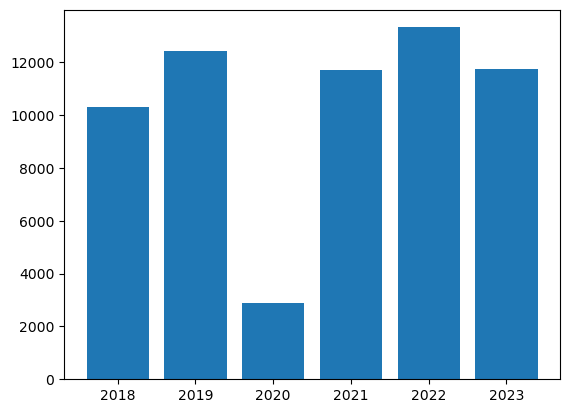

In [35]:
# Construindo gráfico no matplotlib

import matplotlib.pyplot as plt

plt.bar(df_ano.index, df_ano.values)
plt.show()

In [36]:
#Porcentagem de acidente em relação ao ano de maior número de acidentes(2022)
df_ano/df_ano.max()

2022    1.000000
2019    0.933884
2023    0.881276
2021    0.877974
2018    0.774409
2020    0.217186
Name: data, dtype: float64

<function matplotlib.pyplot.show(close=None, block=None)>

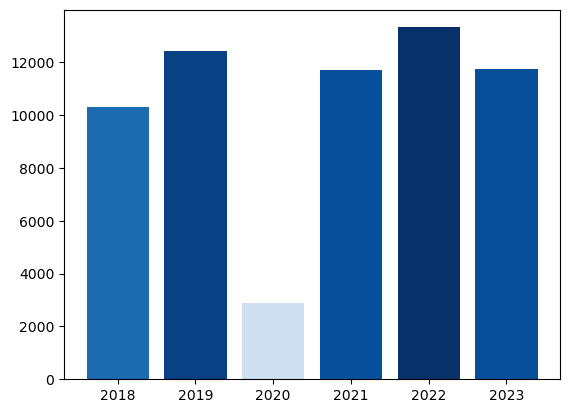

In [37]:
gradiente = df_ano/df_ano.max()
cores = plt.cm.Blues(gradiente)

plt.bar(df_ano.index, df_ano.values, color = cores)
plt.show